# Advanced Lane Finding Pipeline

### Summary

This program will attempt to find lane lines for a self-driving using the openCV library and advanced computer vision techniques to track the lane through curves. 

This project was completed towards an Udacity Nanodegree program in Self-driving Car Engineering.

## Importing Libraries

In [1]:
import numpy as np
import cv2
import glob
import sys
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from collections import deque

from moviepy.editor import VideoFileClip
from IPython.display import HTML

%matplotlib inline
np.set_printoptions(threshold=sys.maxsize)

### Function to display images

In [2]:
def display_images(images, c = 4, r = 4):
    '''
    This function will display images in a grid set by the sizes of c and r.
    The number of rows and columns must be high enough to accomdate the
    number of images 
    :param images: list of images to be shown in the grid
    :param c: number of columns in the grid
    :param r: number of rows in the grid
    :return: displays images as per the plt.show() function
    '''
    # Visualize transformation
    w = 20
    h = 20
    fig = plt.figure(figsize=(50, 50))
    columns = c
    rows = r
    
    for i in range(1, len(images) + 1):
        img = images[i-1]
        fig.add_subplot(rows, columns, i)
        plt.imshow(img,  cmap = plt.cm.gray)
    plt.show()

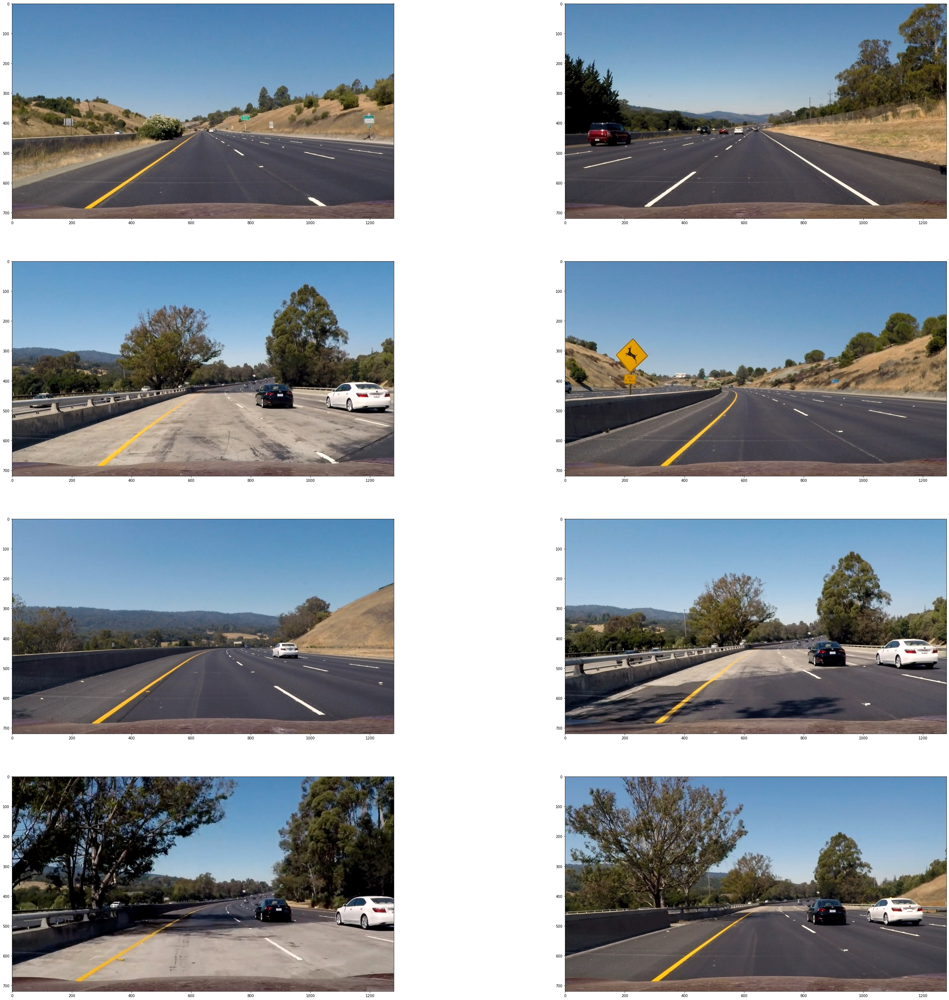

In [3]:
images = []
glob_ims = 'test_images/*.jpg'
for f in glob.glob(glob_ims):
    img = mpimg.imread(f)
    images.append(img)
display_images(images, c=2, r=4)

In [4]:
class Camera(object):
    '''
    Camera class is used to store the camera parameters and its relevant
    functions required for calibration
    '''

    def __init__(self, images, pattern_size=(9, 6), draw=False):
        self.pattern = pattern_size
        self.matrix = None
        self.dist = None
        self.successful_images = []
        self.failed_images = []
        self.draw = draw
        self.calibrate(images, pattern_size)

    def undistort(self, img):
        '''
        Function to remove camera's radial distortion produced through
        the pin-hole camera model. Camera must be calibrated first so
        matrix and dist members are not None.
        :param img: image to be undistorted
        :return: undistorted image
        '''
        if self.matrix is not None and self.dist is not None:
            undistorted_image = cv2.undistort(img, self.matrix, self.dist, None, self.matrix)
            return undistorted_image
        else:
            return img

    def calibrate(self, images, pattern_size):
        '''
        Calibrate camera based on chess board images fed into into the function.
        :param images: chessboard images of black and white squares
        :param pattern_size: size of the chess board in the images
        :return: function will set the values self.matrix and self.dist members
        '''
        pattern = np.zeros((pattern_size[1] * pattern_size[0], 3), np.float32)
        pattern[:, :2] = np.mgrid[0:pattern_size[0], 0:pattern_size[1]].T.reshape(-1, 2)
        object_points = []
        image_corners = []

        for i, path, in enumerate(images):
            image = plt.imread(path)
            gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
            ret, corners = cv2.findChessboardCorners(gray, pattern_size, None)

            if ret:
                object_points.append(pattern)
                image_corners.append(corners)

                xsize = gray.shape[1]
                ysize = gray.shape[0]
                image_size = (xsize, ysize)

                if self.draw is True:
                    cv2.drawChessboardCorners(image, pattern_size, corners, True)
                self.successful_images.append(image)
            else:
                self.failed_images.append(image)

        if object_points and image_corners:
            _, self.matrix, self.dist, _, _ = cv2.calibrateCamera(
                object_points, image_corners, image_size, None, None)

#### Calibrate camera based on calibration images

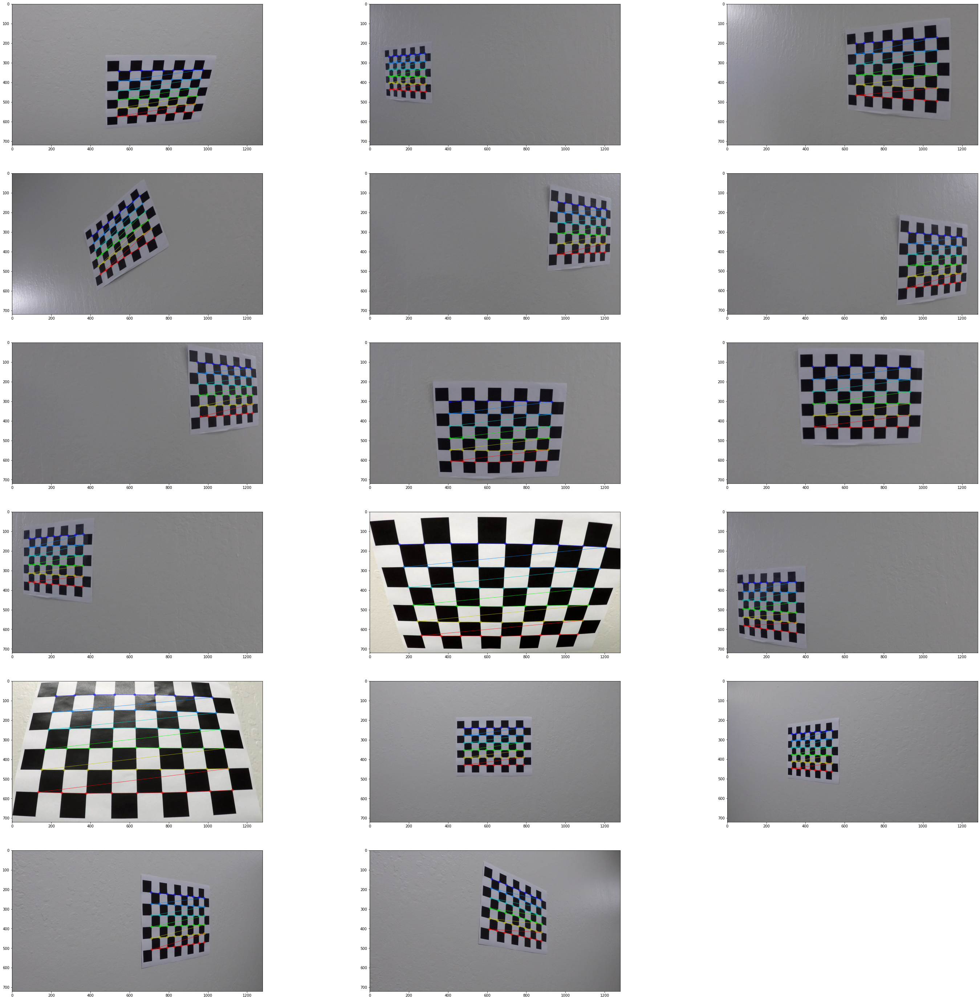

In [5]:
calibration_images = glob.glob('camera_cal/calibration*.jpg')
calibrated_camera = Camera(calibration_images, draw = True)
display_images(calibrated_camera.successful_images, c=3, r=6)

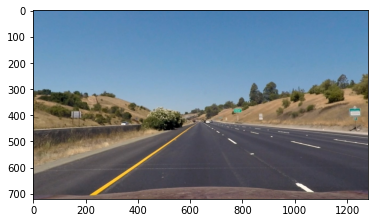

In [6]:
# Check distortion on an image
check = calibrated_camera.undistort(images[0])
plt.imshow(check)

## Gradient and Color Thresholds 

In [7]:
def apply_thresh(img, threshold=(0, 255)):
    '''
    applies thresholds to input 8-bit image
    :param img: input image
    :param threshold: threshold to be applied, must be a tuple of 8-bit values
    :return: resulting mask
    '''
    # scale image to 8 bit
    img_uint8 = np.uint8(255 * img / np.max(img))
    thresh_mask = np.zeros_like(img_uint8)
    thresh_mask[(img_uint8 >= threshold[0]) & (img_uint8 <= threshold[1])] = 1
    return thresh_mask

def sobel_xy_gradients(img, sobel_ksize):
    '''
    apply both x and y edge detection through sobel transform to image
    :param img: input image
    :param sobel_ksize: kernel size for sobel transform
    :return: returns detected edges in two images, x and y
    '''
    x = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=sobel_ksize)
    y = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=sobel_ksize)
    return x, y

def sobel_absolute_value_mask(image, axis='x', sobel_ksize=3, threshold=(0, 255)):
    '''
    applies absolute value component of sobel edge detection and creates a resulting mask
    according to the threshold
    :param image: input image
    :param axis: character input axis to apply the edge detection to in either x
                 or y direction
    :param sobel_ksize: kernel size for sobel transform
    :param threshold: tuple of two values in range of 0 to 255
    :return: threshold-applied mask image
    '''
    if axis == 'x':
        sobel = np.absolute(cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=sobel_ksize))
    elif axis == 'y':
        sobel = np.absolute(cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=sobel_ksize))
    else:
        raise "axis must be specified as x or y value"
    mask = apply_thresh(sobel, threshold)
    return mask


def sobel_magnitude_mask(img, sobel_ksize=3, threshold=(0, 255)):
    '''
    applies magnitude component of sobel edge detection and creates a resulting mask
    according to the threshold
    :param img: input image
    :param sobel_ksize: kernel size for sobel transform
    :param threshold: tuple of two values in range of 0 to 255
    :return: threshold-applied mask image
    '''
    x, y = sobel_xy_gradients(img, sobel_ksize)

    sobel_magnitude = np.sqrt(x ** 2 + y ** 2)
    mask = apply_thresh(sobel_magnitude, threshold)
    return mask


def sobel_direction_mask(img, sobel_ksize=3, threshold=(0, 255)):
    '''
    applies direction component of sobel edge detection and creates a resulting mask
    according to the threshold
    :param img: input image
    :param sobel_ksize: kernel size for sobel transform
    :param threshold: tuple of two values in range of 0 to 255
    :return: threshold-applied mask image
    '''
    x, y = sobel_xy_gradients(img, sobel_ksize)
    sobel_direction = np.arctan2(np.absolute(y), np.absolute(x))
    mask = apply_thresh(sobel_direction, threshold=threshold)
    return mask


def sobel_mask(img):
    '''
    applies three different components of sobel edge detection with individual threshold
    values for each.
    :param img: input image
    :return: mask of edge-detected image
    '''
    sobel_x = sobel_absolute_value_mask(img, axis='x', sobel_ksize=3, threshold=(20, 100))
    sobel_y = sobel_absolute_value_mask(img, axis='y', sobel_ksize=3, threshold=(20, 100))
    magnitude = sobel_magnitude_mask(img, sobel_ksize=3, threshold=(20, 100))
    direction = sobel_direction_mask(img, sobel_ksize=3, threshold=(0.7, 1.3))

    s_mask = np.zeros_like(img)
    s_mask[((sobel_x == 1) & (sobel_y == 1)) |
           ((magnitude == 1) & (direction == 1))] = 1

    return s_mask


def hls(img):
    '''
    transforms image to the HLS colorspace from RGB
    :param img: input image, must be in RGB for correct conversion
    :return: image in HLS colorspace
    '''
    return cv2.cvtColor(img, cv2.COLOR_RGB2HLS)


def color_mask(img):
    '''
    creates a color mask according to the internal threshold inside this
    function
    :param img: input image
    :return: mask of threshold-applied image
    '''
    # c_mask = apply_thresh(img, threshold=(170, 255))
    c_mask = np.zeros_like(img)
    c_mask[(img >= 170) & (img <= 255)] = 1
    return c_mask


def edges_mask(img):
    '''
    function created for better organization
    :param img: input image
    :return: color mas and edges mask
    '''
    c_mask = color_mask(img)
    s_mask = sobel_mask(img)
    return c_mask, s_mask


def find_mask(img):
    '''
    function will apply HLS transform, create masks for edges and color, then 
    combine them into one mask. 
    :param img: input image
    :return: stacked mask of edges and colors
    '''
    hls_img = hls(img)
    # Take only the s channel
    s_channel = hls_img[:, :, 2]
    c_mask, s_mask = edges_mask(s_channel)
    mask = np.zeros_like(s_mask)
    mask[(s_mask == 1) | (c_mask == 1)] = 1
    return mask

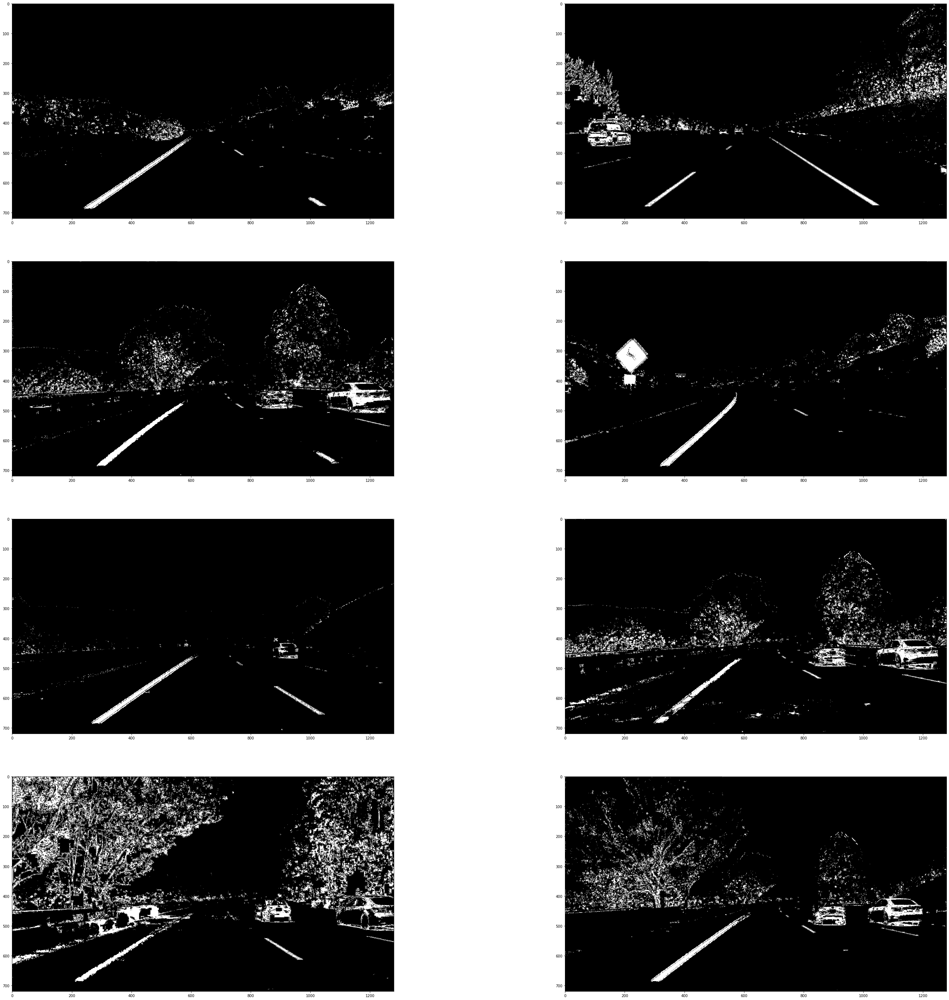

In [10]:
sobel_images = []
for img in images:
    sobel = find_mask(img)
    sobel_images.append(sobel)
display_images(sobel_images, c=2, r=4)

## Perspective Transform

Perspective transform is used to transform the lane in front of the car into a top down view so that lane lines are easier to identify. This is done by specifying source points on the image around the lane lines and destination points to warp the image to which are fed into openCV functions acquire the transform matrix. A similar matrix is then obtained to unwarp the image later on. 

In [11]:
def get_transform_matrix(src, dst):
    return cv2.getPerspectiveTransform(src, dst)

def warp(img, matrix, img_shape):
    return cv2.warpPerspective(img, matrix, img_shape)

def get_unwarp_matrix(dst, src):
    return cv2.getPerspectiveTransform(dst, src)

def transform_lane(img):
    '''
    function will use OpenCV's perspective transform capabilities to warp the
    lane infront of the car into a bird's eye view which will make lane detection
    simpler. 
    :param img: input image to apply perspective transform to
    :return: warped image and the matrix required to unwarp it back to normal
    '''
    # get image shape
    ysize = img.shape[0]
    xsize = img.shape[1]
    
    # source points identified on the image to isolate the lane infront of the car
    src = np.float32([[556, 480],
                      [734, 480],
                      [220, 720],
                      [1105, 720]])
    
    # destination points to warp the image to. 
    dst = np.float32([[300, 0],
                      [900, 0],
                      [300, ysize],
                      [900, ysize]])

    # Get the transform matrix using the source and destination points
    M = get_transform_matrix(src, dst)

    # warp the image using perspective transform
    warped = warp(img, M, (xsize, ysize))

    # find the unwarp matrix by reversing the destination and source arrays
    unwarp_matrix = get_unwarp_matrix(dst, src)

    return warped, unwarp_matrix

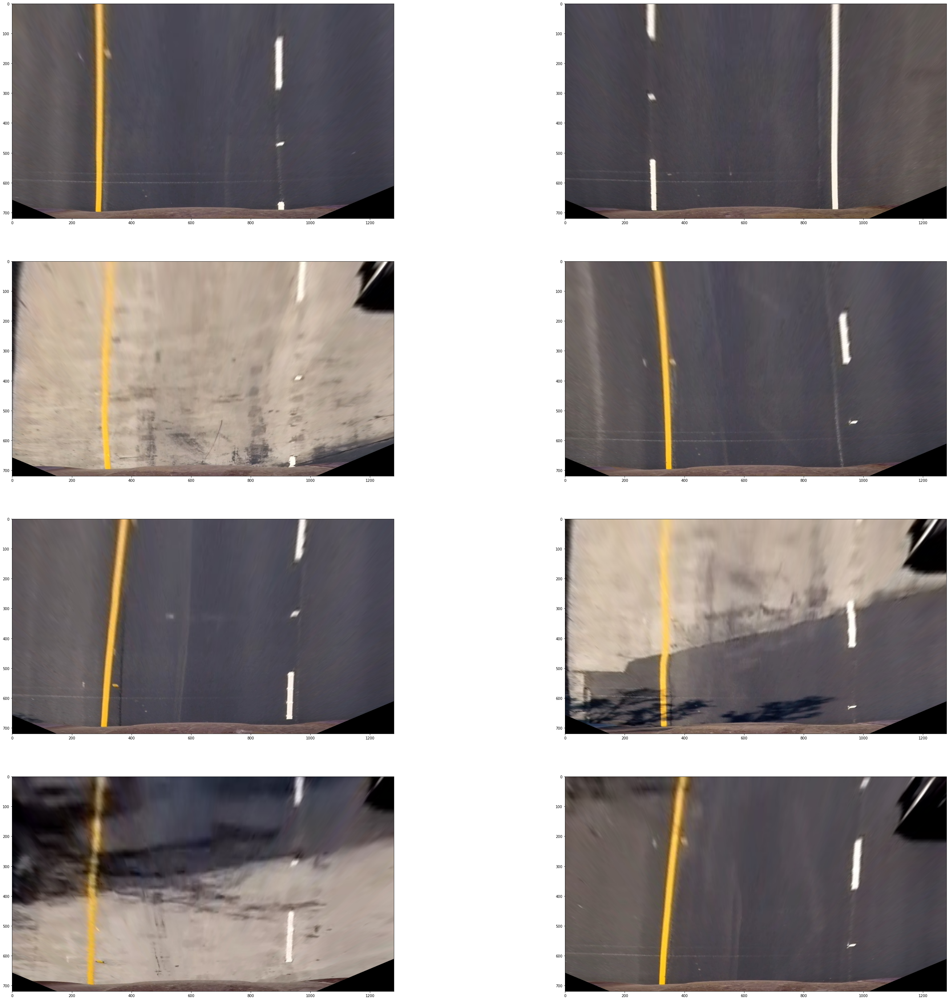

In [12]:
warped_images = []
for img in images:
    warped, _ = transform_lane(img)
    warped_images.append(warped)
display_images(warped_images, c=2, r=4)

## Sliding Window

The sliding window is a simple class object containing the coordinates of the sliding window rectangles used to identify lane lines. The class makes it easier to store the window data for display purposes later and debugging.

In [13]:
class SlidingWindow(object):
    '''
    object is created for every sliding window using a center position,
    position of the bottom and top edges, and a margin value specifying
    the window's x-axis size.
    '''
    def __init__(self, y_low, y_high, center, margin=100, minpix = 50):
        self.y_high = y_high
        self.y_low = y_low
        self.x = center
        self.x_low = self.x - margin
        self.x_high = self.x + margin
        self.center = center
        self.margin = margin
        # minpix is a pixels threshold for window to move its center
        self.minpix = minpix
        # flag if pixels were detected or not
        self.detected = False

    def vertices(self):
        '''
        :return: tuple of two tuples of the rectangles vertices
        '''
        return ((self.x_low, self.y_high), (self.x_high, self.y_low))

    def nonzero_pixels_indices(self, nonzero, win_x=None):
        '''
        finds indices of nonzero pixels where lane lines are likely to be.
        :param nonzero: array of nonzero indices in the image
        :param win_x: position of window center could be specified, deault is None
        :return: indices where lane pixels are detected, referred to as good indices
        '''
        if win_x is not None:
            self.x = win_x

        # check if indices are within the windows area, take only y-positions
        good_inds = ((nonzero[0] >= self.y_high)
                     & (nonzero[0] < self.y_low)
                     & (nonzero[1] >= self.x_low)
                     & (nonzero[1] < self.x_high)
                     ).nonzero()[0]

        # check if window center should be moved
        if len(good_inds) > self.minpix:
            new_center = np.int(np.mean(nonzero[1][good_inds]))
            # additional check to limit windows moving from moving too far away
            if abs(new_center - self.center) > self.margin:
                if new_center > self.center:
                    self.center = self.center + self.margin // 2

                elif new_center < self.center:
                    self.center = self.center - self.margin // 2
            else:
                self.center = new_center
        else:
            self.center = self.x
        # if pixels are found, set flag to True
        if len(good_inds) > 0:
            self.detected = True
            
        return good_inds

## Lane

The lane class takes is created to store information for each separate lane line which can be used across the pipeline to process the lane detection. 

In [14]:
class Lane(object):
    '''
    The lane class takes is created to store information for each 
    separate lane line which can be used across the pipeline to process 
    the lane detection. 
    '''
    def __init__(self, ysize, xsize):
        self.img_ysize = ysize
        self.img_xsize = xsize
        
        self.init_flag = False
        # container for latest line polynomial coefficients 
        self.coef = deque(maxlen = 5)
        
        self.windows = []
        
        # fixed values required for real life measurements
        self.meter_per_x_axis = 700
        self.meter_per_y_axis = 720
        self.land_width = 3.7 
        self.image_lane_length = 30 
        
    def fit_points(self, x_points, y_points):
        '''
        use np.polyfit to fit a line according to the input data and
        store the coefficients.
        :param x_points: x_point data of the line
        :param y_points: y-point data of the line
        '''
        points_flag = len(y_points) > 0 and (np.max(y_points) - np.min(y_points)) > self.img_ysize * 0.625
        no_coef = len(self.coef) == 0

        if points_flag or no_coef:
            self.coef.append(np.polyfit(y_points, x_points, 2))


    def find_good_window(self, nwindows):
        '''
        attempts to find the latest windows which detected pixels so windows don't
        freeze in place when they repeatedly fall of the lane line
        :param nwindows: number of sliding windows in a frame
        :return: SlidingWindow object
        '''
        last_windows = self.windows[-nwindows:]
        good_win = next((win for win in last_windows if win.detected == True), self.windows[-1])
        return good_win


    def generate_lane_points(self):
        '''
        generates the line points using a polynomial equation rounded down to int
        values
        :return: array of line point data (ints)
        '''
        # creat y points for the lane line using the fit_points coefficients
        y = np.linspace(0, self.img_ysize - 1, self.img_ysize)
        fit = np.array(self.coef).mean(axis=0)
        curve = np.stack((fit[0] * y ** 2 + fit[1] * y + fit[2], y)).astype(np.int).T
        return curve


    def get_radius(self):
        '''
        find the radius of the curve by using differentiation of the polynomial
        :return: radius value (int)
        '''
        ym_per_pix = self.image_lane_length / self.meter_per_y_axis
        xm_per_pix = self.land_width / self.meter_per_x_axis

        points = self.generate_lane_points()
        x = points[:, 0]
        y = points[:, 1]

        fit_curve = np.polyfit(y * ym_per_pix, x * xm_per_pix, 2)
        first_derivative = 2 * fit_curve[0] * self.meter_per_y_axis * ym_per_pix + fit_curve[1]
        second_derivative = 2 * fit_curve[0]
        radius = int(((1 + (first_derivative ** 2) ** 1.5) / np.absolute(second_derivative)))
        return radius


    def get_camera_center(self):
        '''
        find the distance from the camera to the lane line
        :return: distance value
        '''
        xm_per_pix = self.land_width / self.meter_per_x_axis

        points = self.generate_lane_points()
        x = points[np.max(points[:, 1])][0]
        from_center = np.absolute((self.img_xsize // 2 - x) * xm_per_pix)
        return from_center

## Helper Functions

In [15]:
def histogram(img):
    '''
    creats a histgram array summing up all the pixel values across the y axis
    :param img: input image
    :return: array of summed pixel values
    '''
    return np.sum(img[img.shape[0] // 2:, :], axis=0)


def create_sliding_windows(ysize, xsize, nonzero, nwindows, window_height, hist):
    '''
    creates sliding windows for both left and right lane
    :param ysize: height of image
    :param xsize: width of image
    :param nonzero: array of indices of nonzero values
    :param nwindows: number of windows to create for each lane
    :param window_height: height of each window dictated by total number of windows
    :param hist: histogram array obtained by the histogram function
    :return: indices of detected pixels by the windows
    '''
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = np.empty([0], dtype=np.int)
    right_lane_inds = np.empty([0], dtype=np.int)

    # start the window loop
    for window in range(nwindows):
        # check if windows were created before
        if len(left_lane.windows) > nwindows or len(right_lane.windows) > nwindows:
            # if so, use latest windows center position
            # left lane
            if (left_lane.windows[-nwindows].detected is True):
                left_win_center = left_lane.windows[-nwindows].center
            else:
                good_window = left_lane.find_good_window(nwindows)
                left_win_center = good_window.center

            # right lane:
            if (right_lane.windows[-nwindows].detected is True):
                right_win_center = right_lane.windows[-nwindows].center
            else:
                good_window = right_lane.find_good_window(nwindows)
                right_win_center = good_window.center

        # else, use the highest histogram value in each half of the image
        else:
            left_win_center = np.argmax(hist[:xsize // 2])
            right_win_center = np.argmax(hist[xsize // 2:]) + xsize // 2

        # iniate dimensions of window
        win_y_high = ysize - (window + 1) * window_height
        win_y_low = ysize - window * window_height

        # Set the width of the windows +/- margin
        margin = 75

        # create left lane window
        left_win = SlidingWindow(win_y_low,
                                 win_y_high,
                                 left_win_center,
                                 margin)

        # create right lane window
        right_win = SlidingWindow(win_y_low,
                                  win_y_high,
                                  right_win_center,
                                  margin)

        # Add the nonzero indices
        left_lane_inds = np.append(left_lane_inds, left_win.nonzero_pixels_indices(nonzero), axis=0)
        right_lane_inds = np.append(right_lane_inds, right_win.nonzero_pixels_indices(nonzero), axis=0)

        # append window to list stored inside lane object
        left_lane.windows.append(left_win)
        right_lane.windows.append(right_win)

    return left_lane_inds, right_lane_inds


def create_lane_overlay(img, unwrap_m=None):
    '''
    attempts to draw a green polygon, usually a rectangle, to fit the lane
    according to the fit data
    :param image: image to draw on
    :param unwrap_m: unwarp matrix obtained through transform_lane
    :return: a combined weighted image with the lane detection polygon drawn
    '''
    overlay = np.zeros_like(img).astype(np.uint8)
    points = np.vstack((left_lane.generate_lane_points(),
                        np.flipud(right_lane.generate_lane_points())))

    cv2.fillPoly(overlay, [points], (0, 255, 0))

    if unwrap_m is not None:
        overlay = cv2.warpPerspective(overlay, unwrap_m, (img.shape[1], img.shape[0]))

    alpha = 0.6
    return cv2.addWeighted(img, alpha, overlay, 1 - alpha, 0)


def create_info_overlay(img, nwindows):
    '''
    draws the windows for each lane in the frame and fits the lane line through them
    :param img: input frame to draw on
    :param nwindows: number of windows specified earlier in the pipeline
    :return: a combined weighted image with the sliding windows and fit line drawn
    '''
    if len(img.shape) == 2:
        img = np.dstack((img, img, img))
    else:
        img = img

    for window in left_lane.windows[-nwindows:]:
        vertices = window.vertices()
        cv2.rectangle(img, vertices[0], vertices[1], (1.0, 1.0, 0), 2)

    for window in right_lane.windows[-nwindows:]:
        vertices = window.vertices()
        cv2.rectangle(img, vertices[0], vertices[1], (1.0, 1.0, 0), 2)

    cv2.polylines(img, [left_lane.generate_lane_points()], False, (1.0, 1.0, 0), 2)
    cv2.polylines(img, [right_lane.generate_lane_points()], False, (1.0, 1.0, 0), 2)

    return img * 255


def create_overlays(img, sobel, nwindows):
    '''
    creates two overlays at the top of the video to visualize the lane tracking
    and the perspective warp
    :param img: current frame from video file
    :param sobel: the edge and color detection mask
    :param nwindows: number of windows specified earlier in the pipeline
    :return: two images to be combined with the video
    '''
    sobel_warp = transform_lane(sobel)[0]
    info_overlay = create_info_overlay(sobel_warp, nwindows)
    top_overlay = create_lane_overlay(transform_lane(img)[0])
    info_overlay = cv2.resize(info_overlay, (0, 0), fx=0.3, fy=0.3)
    top_overlay = cv2.resize(top_overlay, (0, 0), fx=0.3, fy=0.3)
    return info_overlay, top_overlay


def radius_of_curvature():
    '''
    finds the average of the radius of curvature between the two lane lines
    :return: returns the average radius of curvature value
    '''
    radius = int(np.average([left_lane.get_radius(),
                             right_lane.get_radius()]))
    return radius


def draw_text(img, text, x, y):
    '''
    draws text on the input image according to the input positions
    :param img: input img
    :param text: text to be drawn
    :param x: x position of text
    :param y: y position of text
    '''
    cv2.putText(img, text, (x, y), cv2.FONT_HERSHEY_DUPLEX, 0.8, (255, 255, 255), 2)

## Pipeline

In [16]:
def pipeline(img_):
    
    # input frame is copied due to read-only nature of files
    img = np.copy(img_)
    
    # remove radial distortion of image
    undistorted_img = calibrated_camera.undistort(img)
    img_shape = undistorted_img.shape
    
    # find edges using sobel edge detection and color transform
    sobel = find_mask(img)
    
    # warp the image to birds-eye view to make edge detection easier
    warp, unwrap_matrix = transform_lane(sobel)
    
    # height and width values of image which will be used later
    ysize = warp.shape[0]
    xsize = warp.shape[1]
    
    # separate the nonzero values 
    nonzero = warp.nonzero()
    
    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9

    # Set minimum number of pixels found to recenter window
    minpix = 100
    
    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(ysize//nwindows)
    
    # find the sum of pixel values across the y-axis
    hist = histogram(warp)
    
    # create sliding windows for each lane and find indices of detected pixels
    left_lane_inds, right_lane_inds = create_sliding_windows(ysize, xsize, nonzero, nwindows, window_height, hist)

    nonzeroy = nonzero[0]
    nonzerox = nonzero[1]
    
    # fit lines to the lane lines in each lane
    left_lane.fit_points(nonzerox[left_lane_inds],
                         nonzeroy[left_lane_inds])
    
    right_lane.fit_points(nonzerox[right_lane_inds],
                         nonzeroy[right_lane_inds])
    
    # create overlays 
    info_overlay, top_overlay = create_overlays(img, sobel, nwindows)
    
    if info_overlay is None or top_overlay is None:
        return img

    img[:250, :, :] = img[:250, :, :] * 0.4
    (ysize, xsize, _) = info_overlay.shape        
    img[25:25 + ysize, 25:25 + xsize, :] = info_overlay
    img[25:25 + ysize, 25 + 25 + xsize:25 + 25 + xsize + xsize, :] = top_overlay
    text_x = 25 + 25 + xsize + xsize + 25

    lane_width = left_lane.get_camera_center() + right_lane.get_camera_center() 
    off_center = right_lane.get_camera_center() - lane_width / 2
    draw_text(img, 'Radius of curvature:  {} m'.format(radius_of_curvature()), text_x, 80)
    draw_text(img, 'Distance from lane center:    {:.1f} m'.format(off_center), text_x, 140)

    img = create_lane_overlay(img, unwrap_matrix)
        
    return img
    

In [17]:
def prepare_pipeline(img):
    global left_lane
    global right_lane
    
    ysize = img.shape[0]
    xsize = img.shape[1]
    
    #initialize right and left lane lines
    left_lane  = Lane(ysize, xsize)
    right_lane = Lane(ysize, xsize)

## Test Image

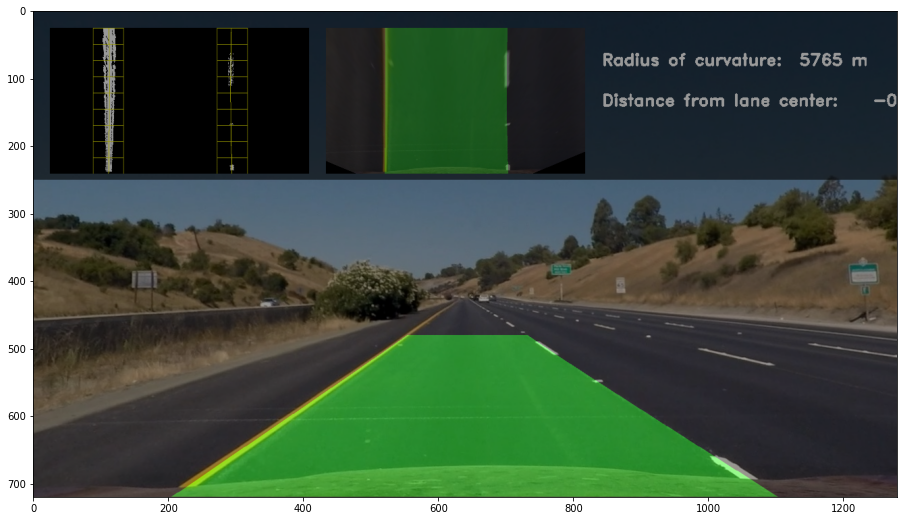

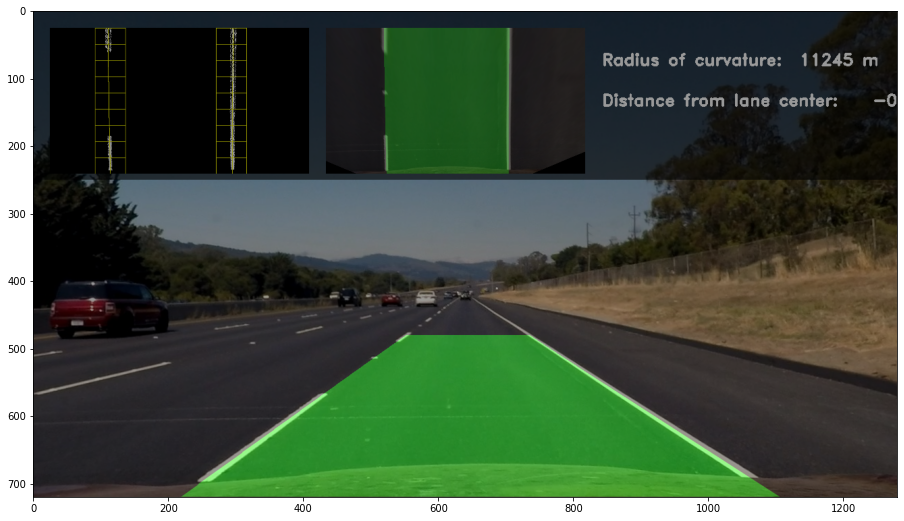

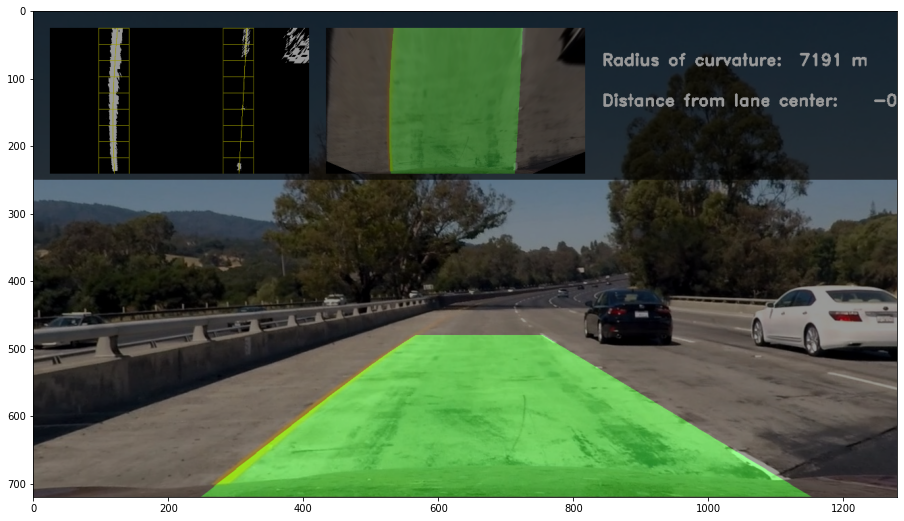

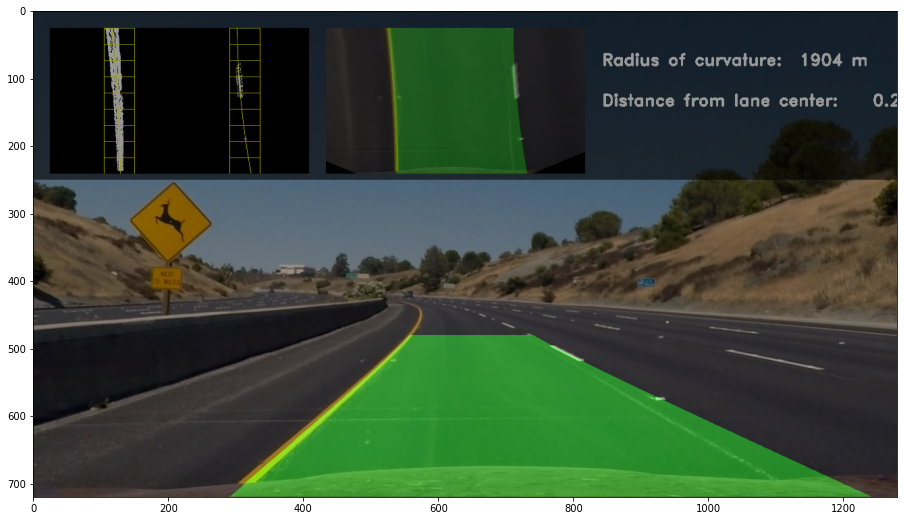

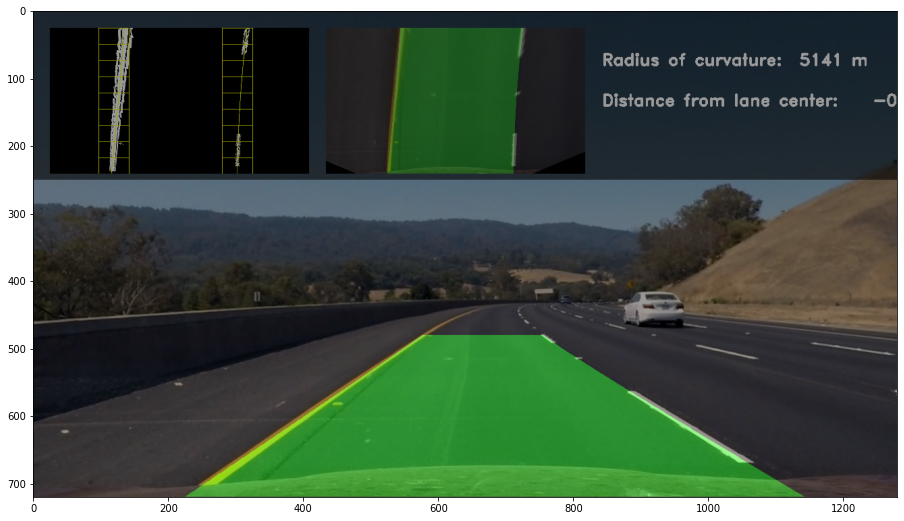

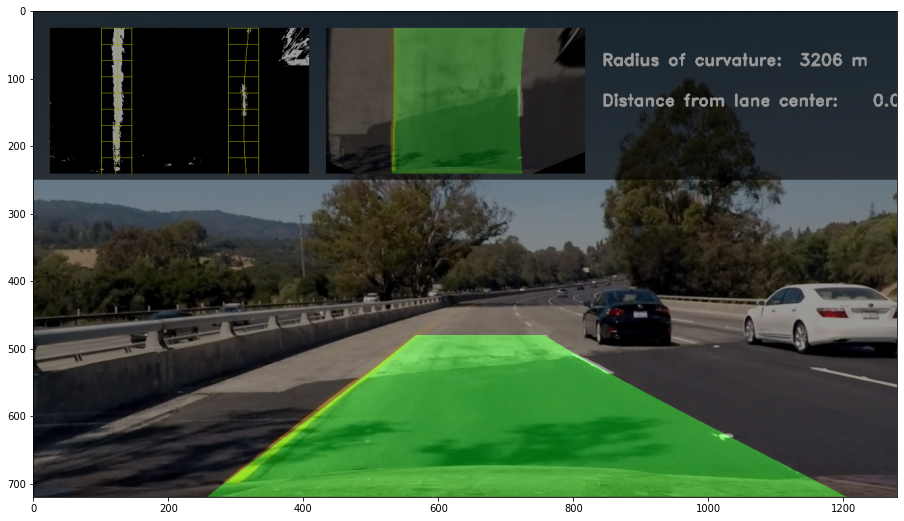

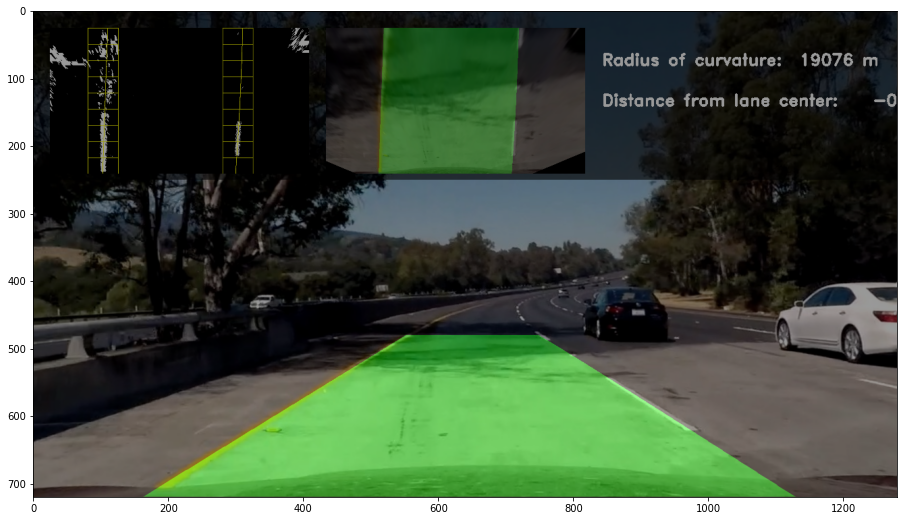

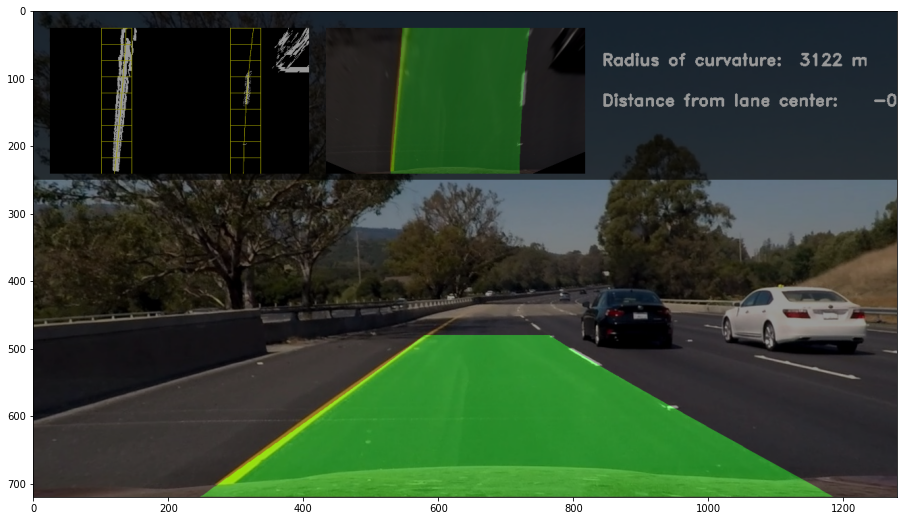

In [18]:
for f in glob.glob('test_images/*.jpg'):
    img = mpimg.imread(f)
    prepare_pipeline(img)
    calibrated = calibrated_camera.undistort(img)
    output = pipeline(calibrated)
    
    mpimg.imsave(f.replace('test_images', 'output_images'), output)
    plt.figure(figsize=(12, 12))
    plt.imshow(output)
    plt.subplots_adjust(left=0.0, right=1, top=0.9, bottom=0.0)
    plt.show()

## Video Test

In [19]:
def process_video(file_name):
    
    output_video_name = 'output_videos/{}_processed.mp4'.format(file_name)
    input_video = VideoFileClip("videos/{}.mp4".format(file_name))
    
    first_frame = input_video.get_frame(0)
    prepare_pipeline(first_frame)
    output_video = input_video.fl_image(pipeline)

    %time output_video.write_videofile(output_video_name, audio=False)

In [20]:
process_video('project_video')

t:   0%|                                                                            | 0/1260 [00:00<?, ?it/s, now=None]

Moviepy - Building video output_videos/project_video_processed.mp4.
Moviepy - Writing video output_videos/project_video_processed.mp4



Moviepy - Done !
Moviepy - video ready output_videos/project_video_processed.mp4
Wall time: 5min 42s
